In [1]:
!pip install -U peft transformers diffusers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.3/168.3 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 17.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.7/265.7 kB 20.3 MB/s eta 0:00:00


In [2]:
from PIL import Image

def image_grid(imgs, rows, cols, resize=256):
    assert len(imgs) == rows * cols

    if resize is not None:
        imgs = [img.resize((resize, resize)) for img in imgs]
    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

In [3]:
import torch
generator = torch.Generator("cuda").manual_seed(27827)


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Without Prior Preservation

In [5]:
from diffusers import DiffusionPipeline,DDIMScheduler
from diffusers import DiffusionPipeline, AutoencoderKL

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipe = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae, torch_dtype=torch.float16, variant="fp16",
    use_safetensors=True
)

pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
pipe.load_lora_weights("/content/drive/My Drive/sdxl-karim-no_prior-1000",weight_name="pytorch_lora_weights.safetensors", adapter_name="raj")
pipe.enable_vae_slicing()

_ = pipe.to("cuda")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

##Recontextualization

  0%|          | 0/50 [00:00<?, ?it/s]

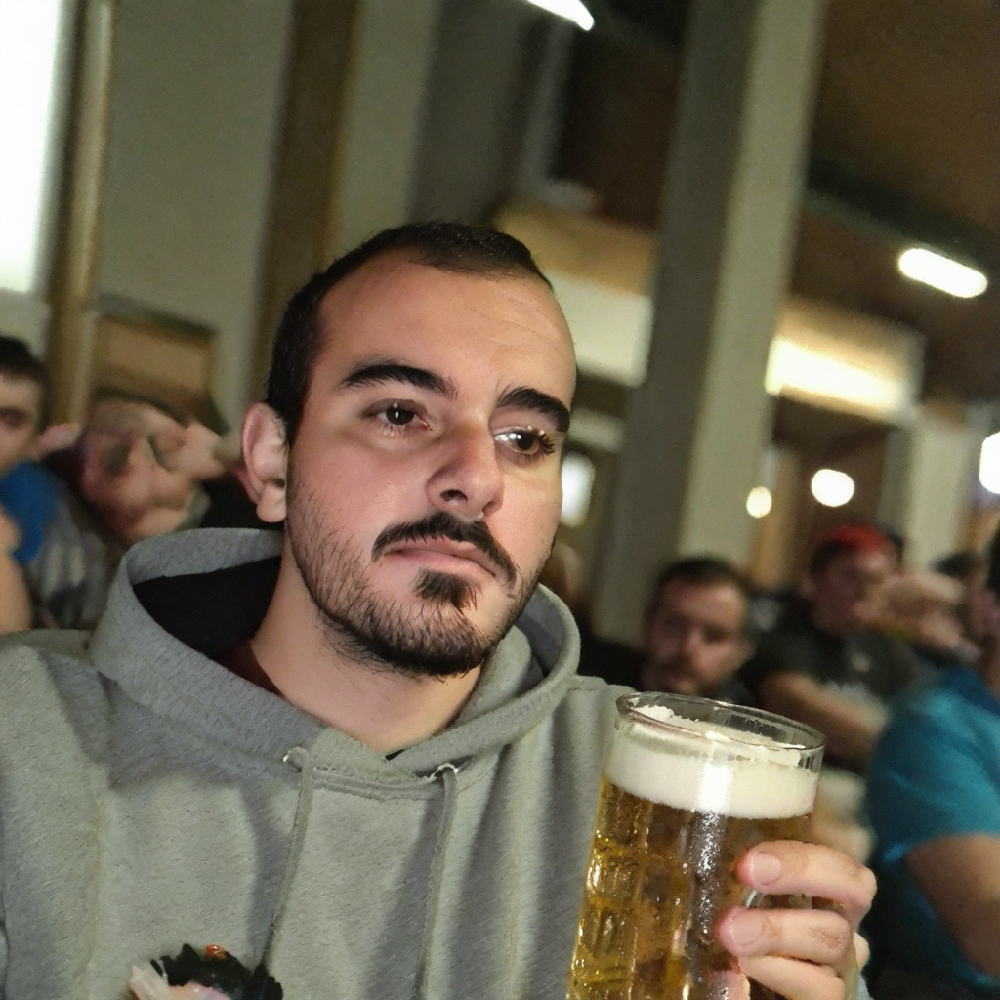

In [8]:
prompt = "a of karim person at Oktoberfest"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Art Renditions

  0%|          | 0/80 [00:00<?, ?it/s]

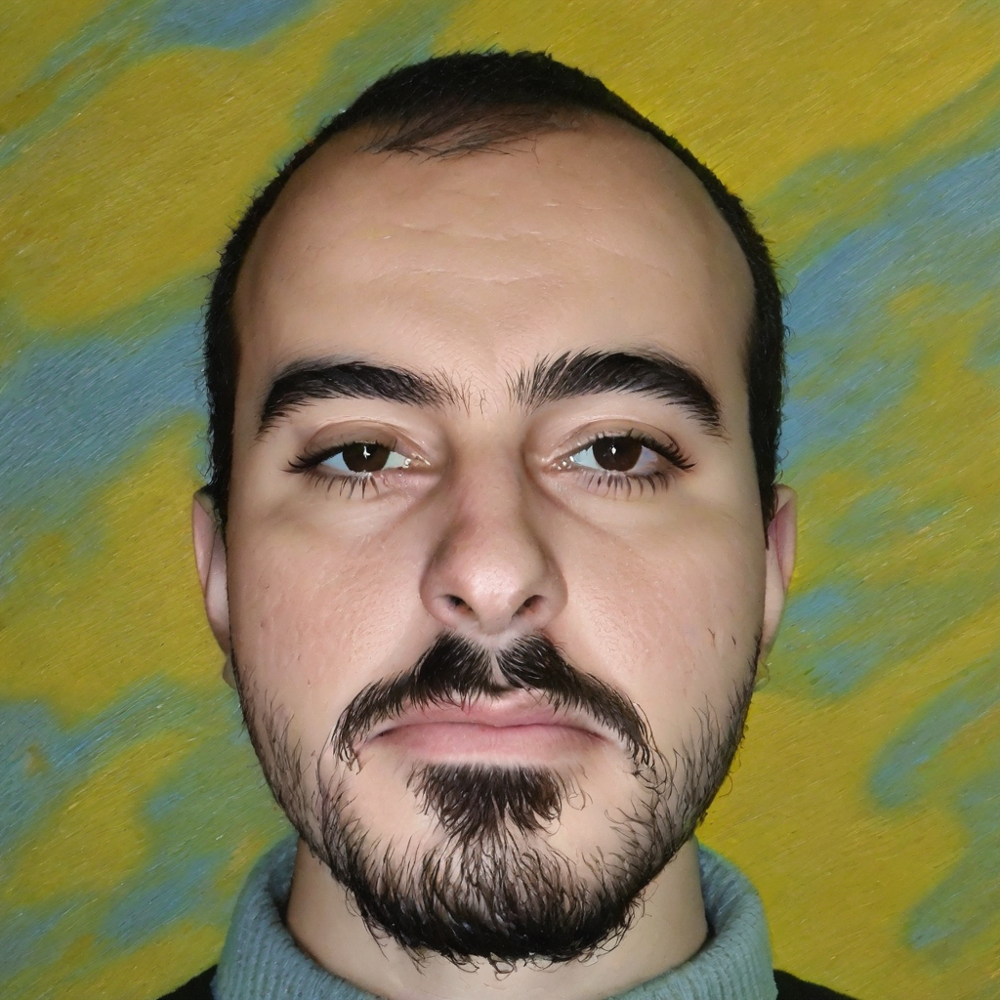

In [9]:
prompt = "a painting of karim person in the style of Van Gogh"
image = pipe(prompt=prompt, num_inference_steps=80,generator=generator).images[0]
image

##Property Modification

  0%|          | 0/50 [00:00<?, ?it/s]

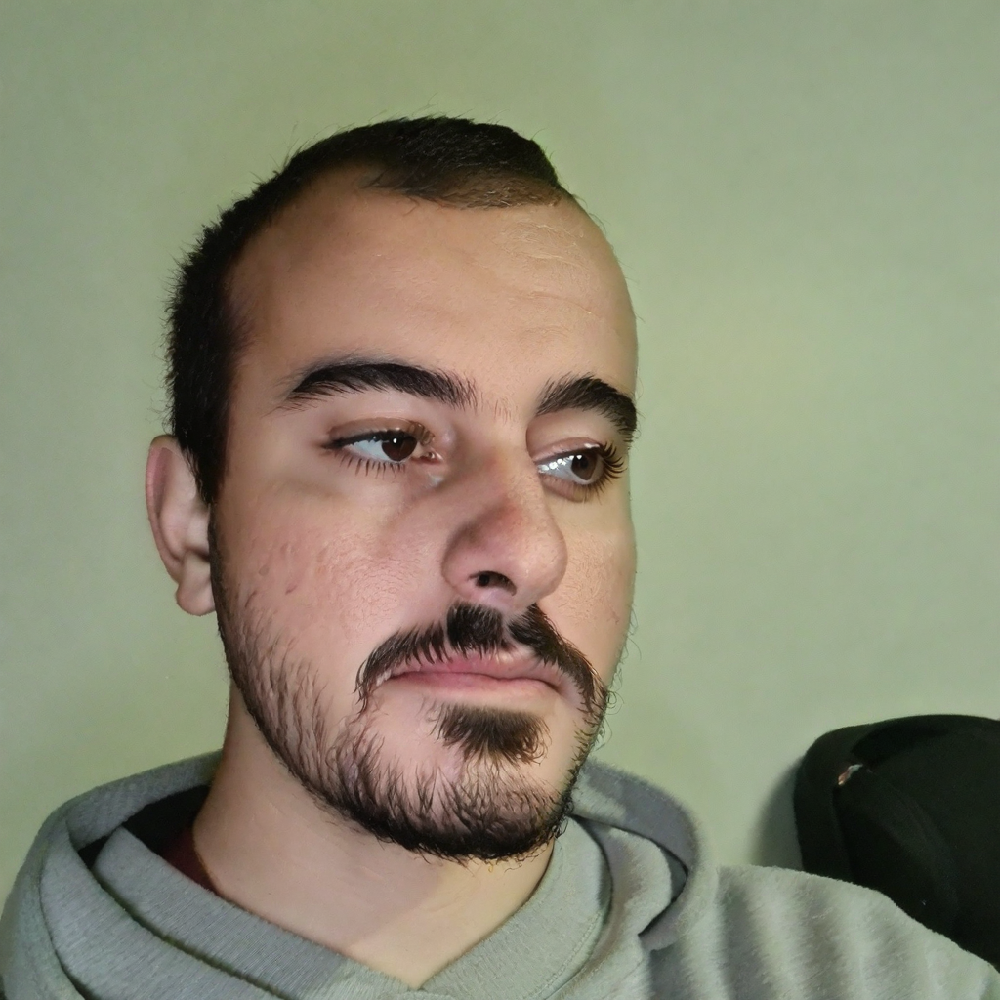

In [12]:
prompt = "a of karim person with blonde hair"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Accessorization

  0%|          | 0/50 [00:00<?, ?it/s]

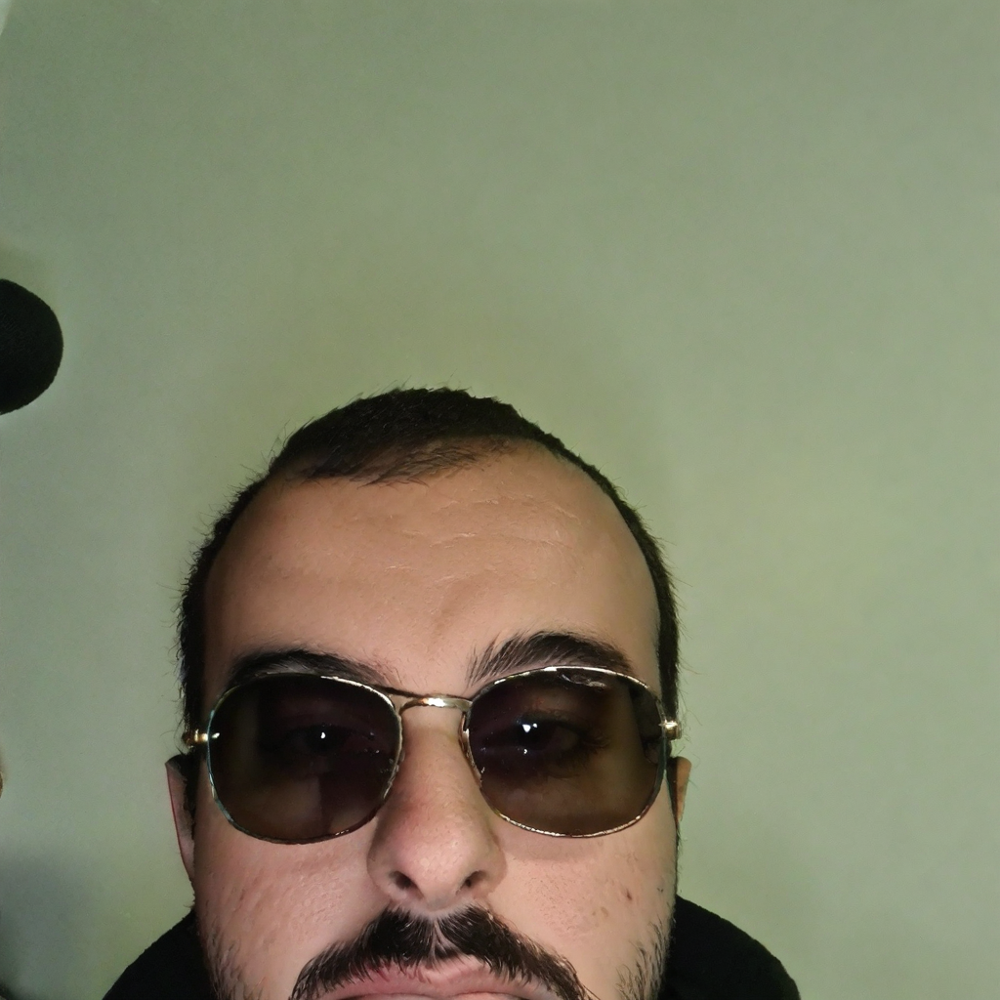

In [13]:
prompt = "a of karim person with sunglasses"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Novel-View Synthesis

  0%|          | 0/50 [00:00<?, ?it/s]

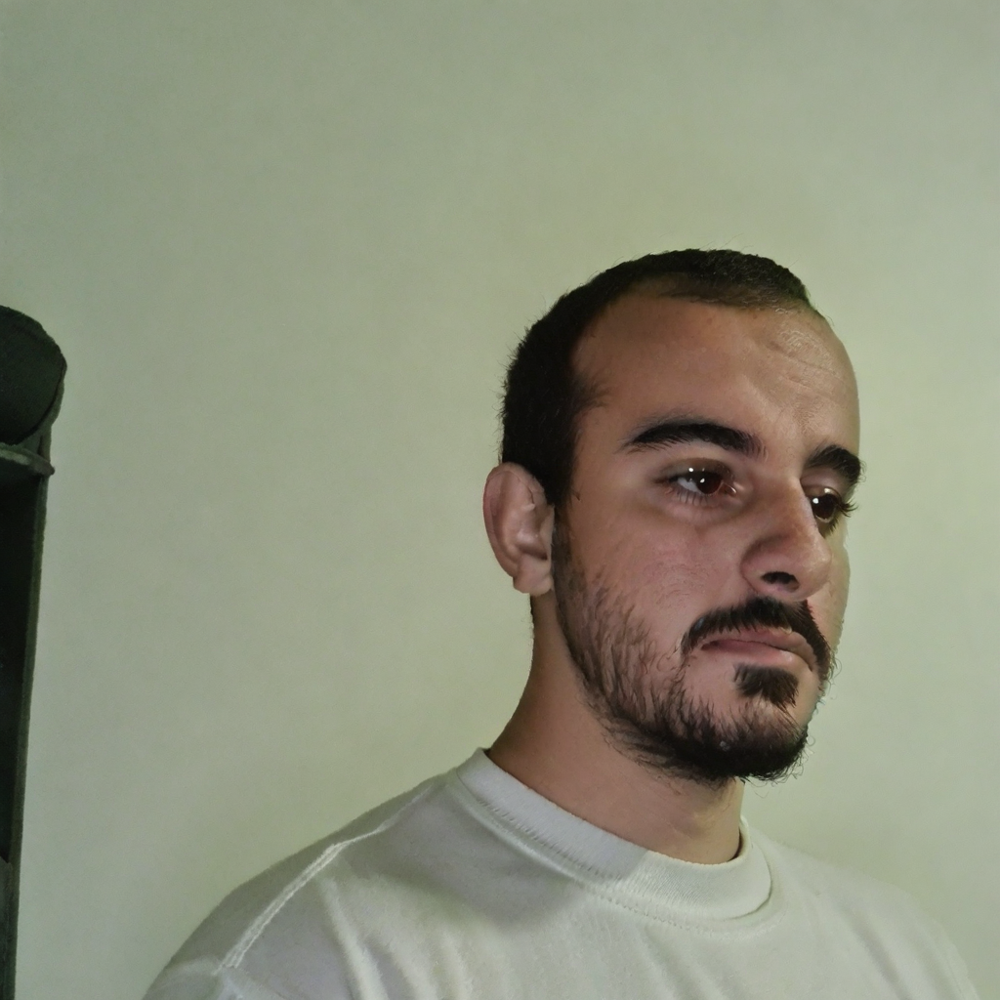

In [11]:
prompt = "a side view photo of karim person"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Merging Adapters - Pixel Art

In [6]:
pipe.load_lora_weights("nerijs/pixel-art-xl", weight_name="pixel-art-xl.safetensors", adapter_name="pixel")


pixel-art-xl.safetensors:   0%|          | 0.00/171M [00:00<?, ?B/s]

In [7]:
pipe.set_adapters(["pixel", "raj"], adapter_weights=[1.2, 0.85])


  0%|          | 0/80 [00:00<?, ?it/s]

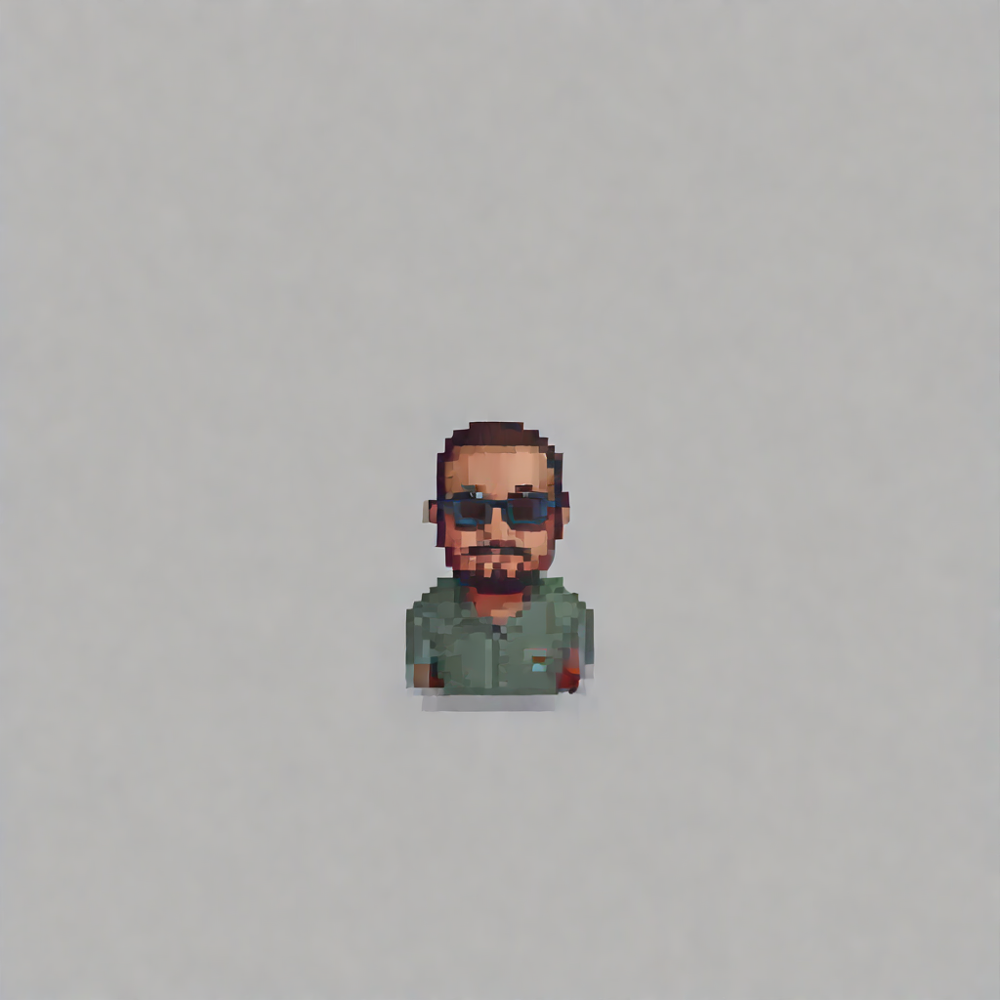

In [8]:
prompt = "pixel, a photo of karim person wearing sunglasses"
image = pipe(
    prompt, num_inference_steps=80, cross_attention_kwargs={"scale": 1.0},generator=generator
).images[0]
image

##Regular Prompt

###DDIM

50 Steps

  0%|          | 0/50 [00:00<?, ?it/s]

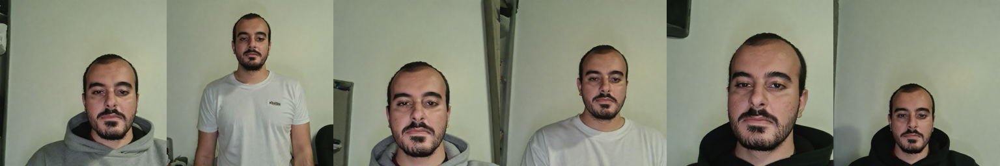

In [16]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=50,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [17]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/DDIM_50_steps"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r DDIM_50_steps.zip "/content/drive/My Drive/DDIM_50_steps"

  adding: content/drive/My Drive/DDIM_50_steps/ (stored 0%)
  adding: content/drive/My Drive/DDIM_50_steps/0.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps/1.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps/2.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps/3.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps/4.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps/5.png (deflated 0%)


80 steps

  0%|          | 0/50 [00:00<?, ?it/s]

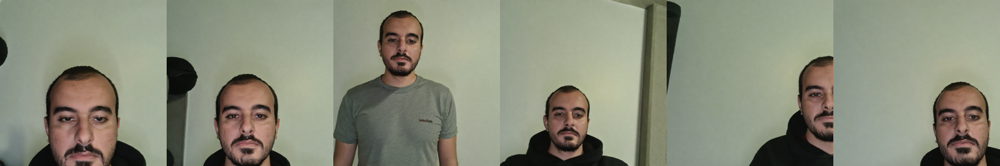

In [11]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=50,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [15]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/DDIM_80_steps/"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r DDIM_80_steps.zip "/content/drive/My Drive/DDIM_80_steps/"

  adding: content/drive/My Drive/DDIM_80_steps/ (stored 0%)
  adding: content/drive/My Drive/DDIM_80_steps/0.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps/1.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps/2.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps/3.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps/4.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps/5.png (deflated 0%)


###PNDM

In [20]:
from diffusers import PNDMScheduler

pipe.scheduler = PNDMScheduler.from_config(pipe.scheduler.config)

50 steps

  0%|          | 0/50 [00:00<?, ?it/s]

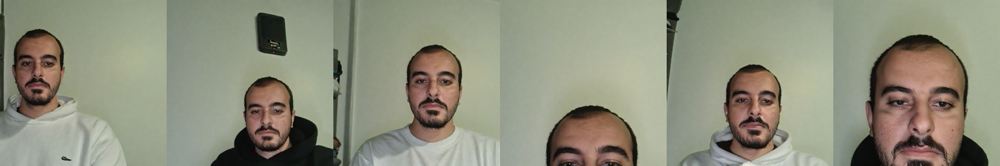

In [21]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=50,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [22]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/PNDM_50_steps"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r PNDM_50_steps.zip "/content/drive/My Drive/PNDM_50_steps"

  adding: content/drive/My Drive/PNDM_50_steps/ (stored 0%)
  adding: content/drive/My Drive/PNDM_50_steps/0.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_50_steps/1.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_50_steps/2.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_50_steps/3.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_50_steps/4.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_50_steps/5.png (deflated 0%)


80 steps

  0%|          | 0/50 [00:00<?, ?it/s]

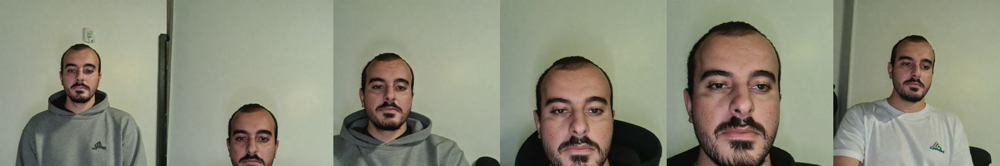

In [23]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=50,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [24]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/PNDM_80_steps"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r PNDM_80_steps.zip "/content/drive/My Drive/PNDM_80_steps"

  adding: content/drive/My Drive/PNDM_80_steps/ (stored 0%)
  adding: content/drive/My Drive/PNDM_80_steps/0.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps/1.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps/2.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps/3.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps/4.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps/5.png (deflated 0%)


#With Prior Preservation

In [5]:
from diffusers import DiffusionPipeline,DDIMScheduler
from diffusers import DiffusionPipeline, AutoencoderKL

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipe = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae, torch_dtype=torch.float16, variant="fp16",
    use_safetensors=True
)

pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
pipe.load_lora_weights("/content/drive/My Drive/sdxl-karim-1000",weight_name="pytorch_lora_weights.safetensors", adapter_name="karim")
pipe.enable_vae_slicing()

_ = pipe.to("cuda")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

tokenizer_2/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

##Recontextualization

  0%|          | 0/50 [00:00<?, ?it/s]

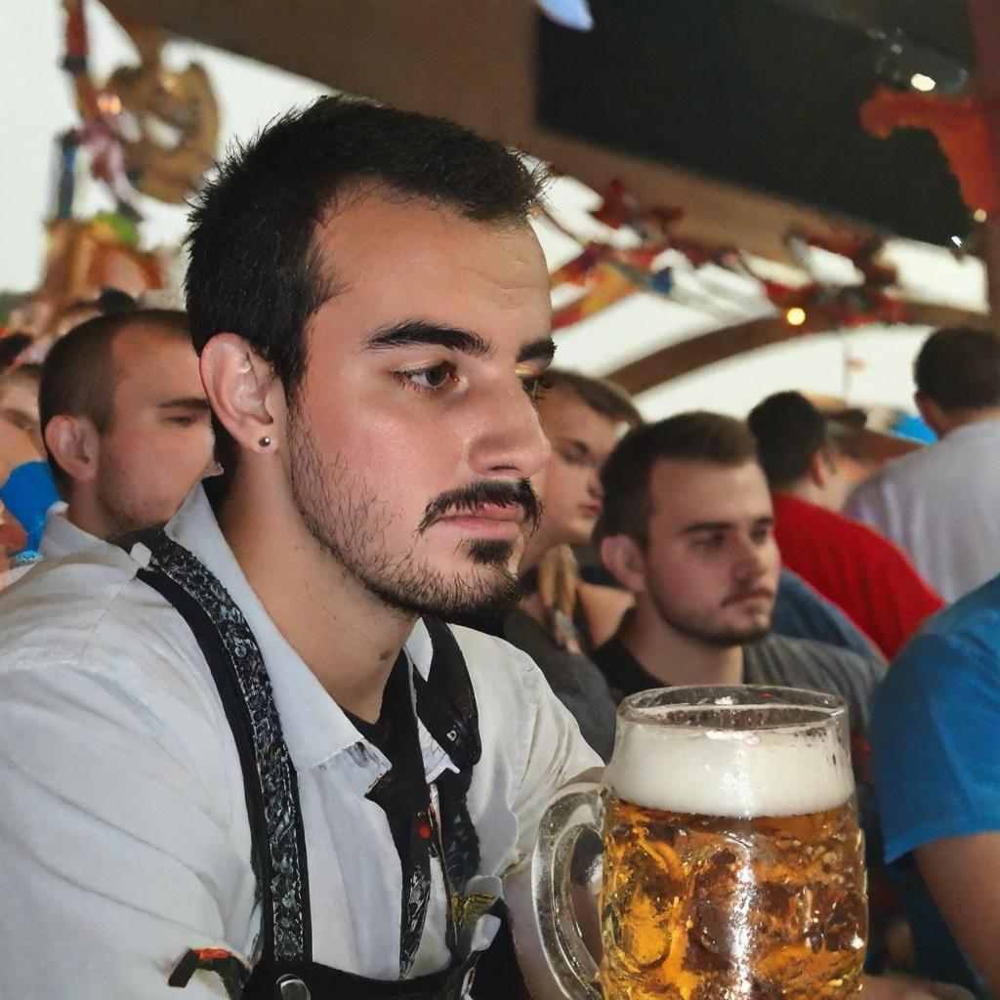

In [6]:
prompt = "a of karim person at Oktoberfest"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Art Renditions

  0%|          | 0/80 [00:00<?, ?it/s]

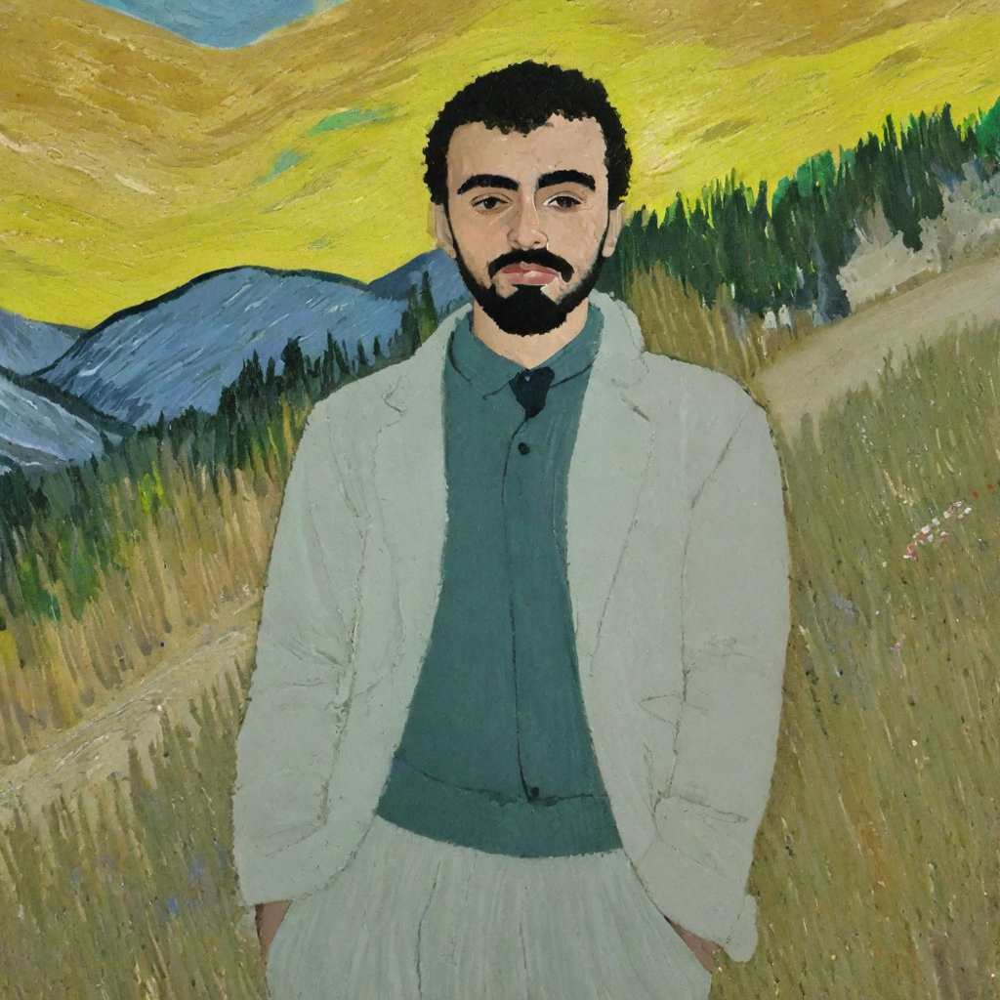

In [7]:
prompt = "a painting of karim person in the style of Van Gogh"
image = pipe(prompt=prompt, num_inference_steps=80,generator=generator).images[0]
image

##Property Modification

  0%|          | 0/50 [00:00<?, ?it/s]

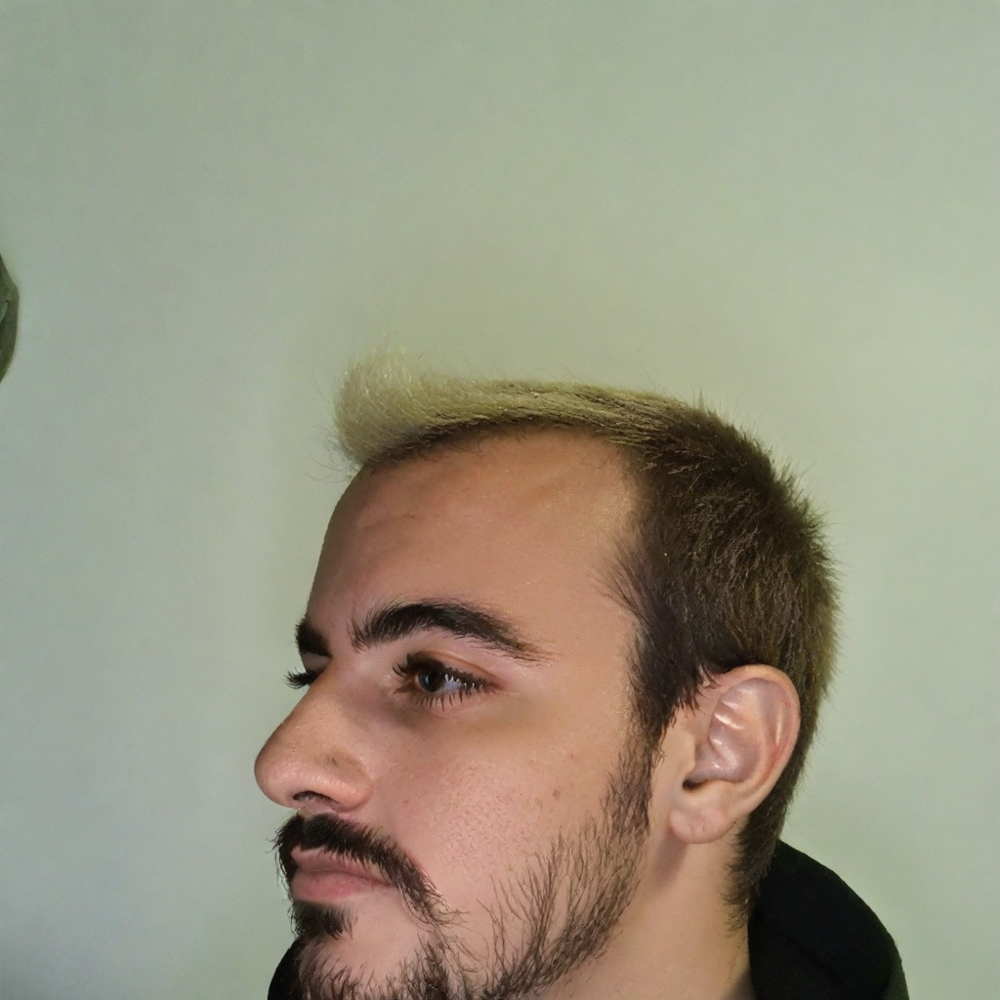

In [8]:
prompt = "a of karim person with blonde hair"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Accessorization

  0%|          | 0/50 [00:00<?, ?it/s]

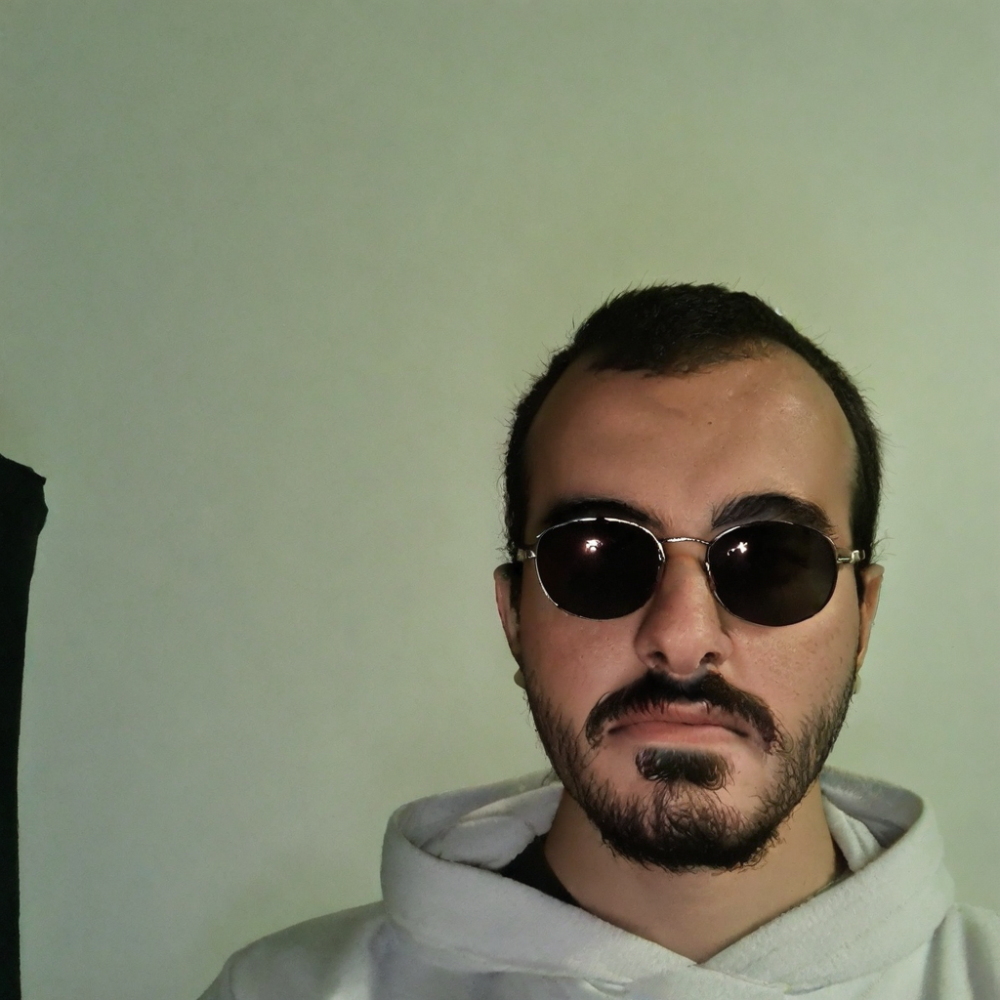

In [9]:
prompt = "a of karim person with sunglasses"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Novel-View Synthesis

  0%|          | 0/50 [00:00<?, ?it/s]

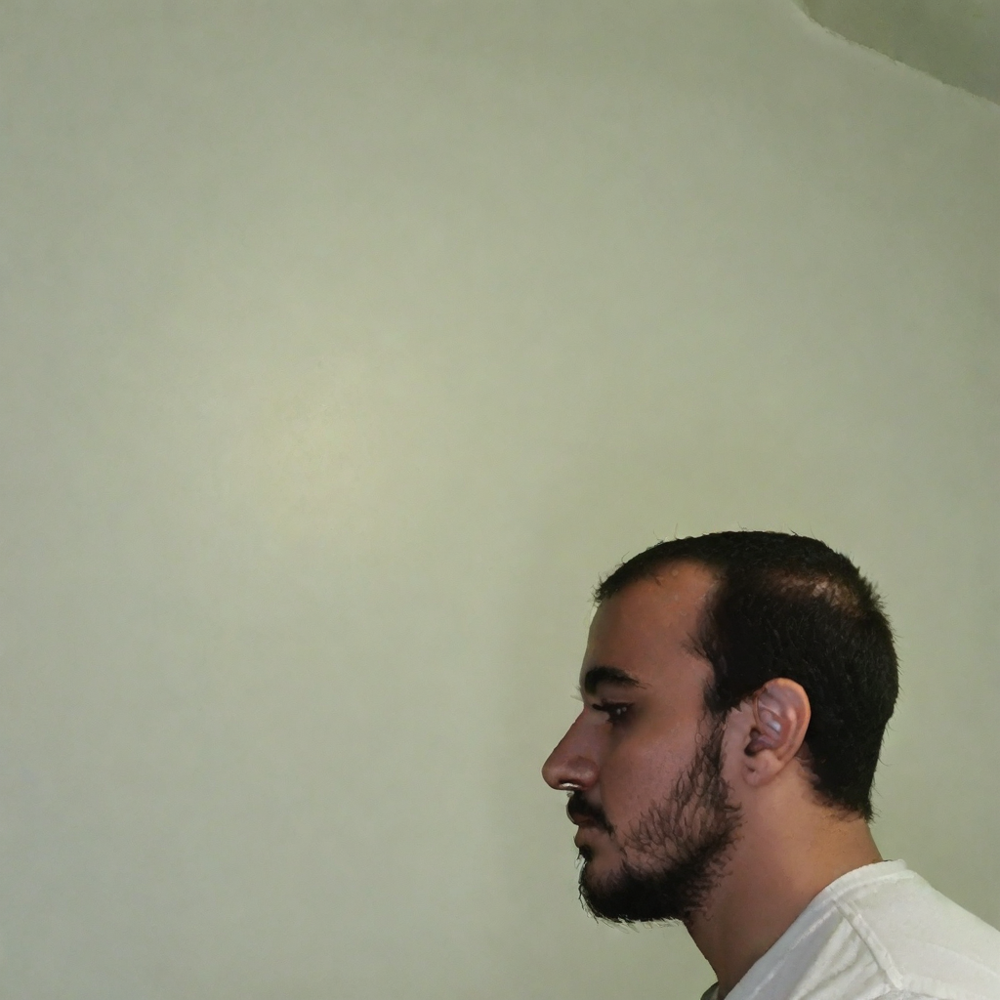

In [18]:
prompt = "a side view photo of karim person"
image = pipe(prompt=prompt, num_inference_steps=50,generator=generator).images[0]
image

##Merging Adapters - Pixel Art

In [11]:
pipe.load_lora_weights("nerijs/pixel-art-xl", weight_name="pixel-art-xl.safetensors", adapter_name="pixel")
pipe.set_adapters(["pixel", "karim"], adapter_weights=[1.2, 0.9])


pixel-art-xl.safetensors:   0%|          | 0.00/171M [00:00<?, ?B/s]

  0%|          | 0/80 [00:00<?, ?it/s]

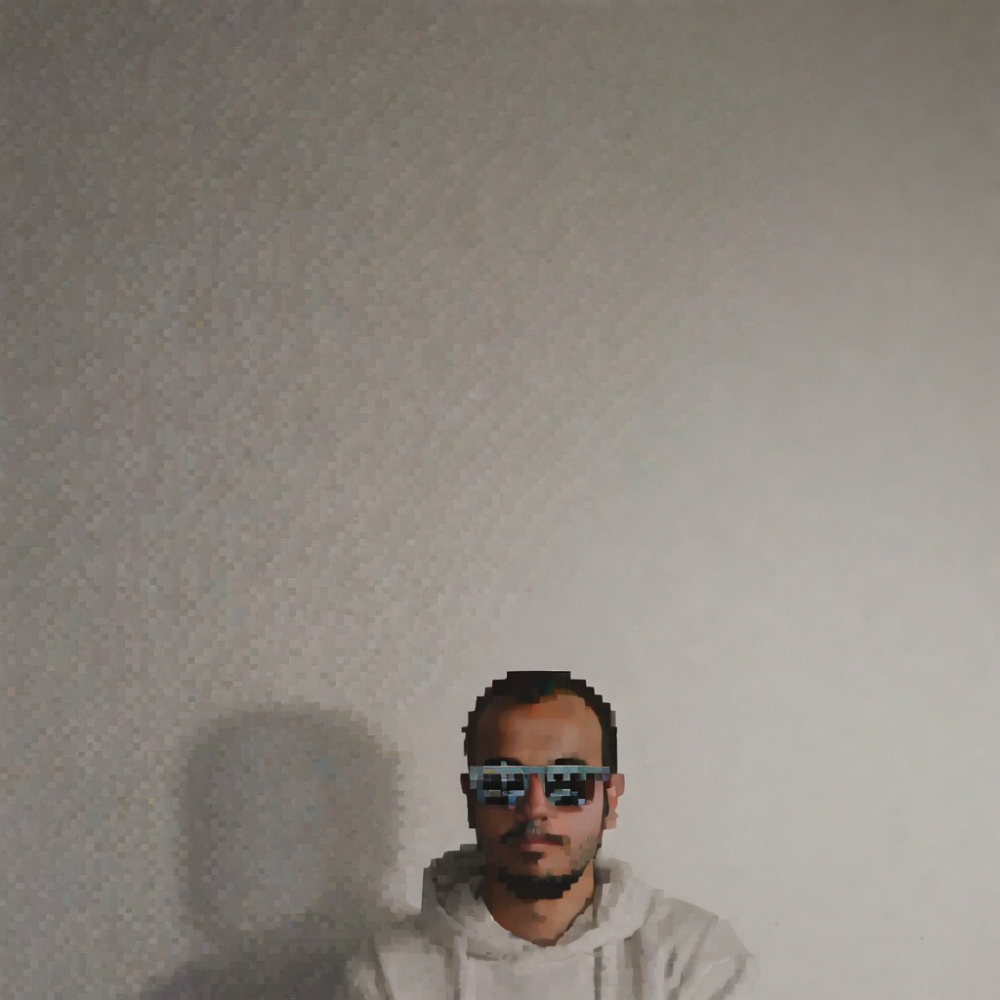

In [12]:
prompt = "pixel, a photo of karim person wearing sunglasses"
image = pipe(
    prompt, num_inference_steps=80, cross_attention_kwargs={"scale": 1.0},generator=generator
).images[0]
image

##Regular Prompt

###DDIM

50 steps

  0%|          | 0/50 [00:00<?, ?it/s]

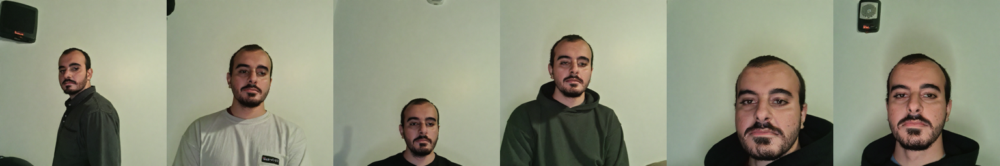

In [19]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=50,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [20]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/DDIM_50_steps_prior"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r DDIM_50_steps_prior.zip "/content/drive/My Drive/DDIM_50_steps_prior"

  adding: content/drive/My Drive/DDIM_50_steps_prior/ (stored 0%)
  adding: content/drive/My Drive/DDIM_50_steps_prior/0.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps_prior/1.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps_prior/2.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps_prior/3.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps_prior/4.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_50_steps_prior/5.png (deflated 0%)


80 steps

  0%|          | 0/80 [00:00<?, ?it/s]

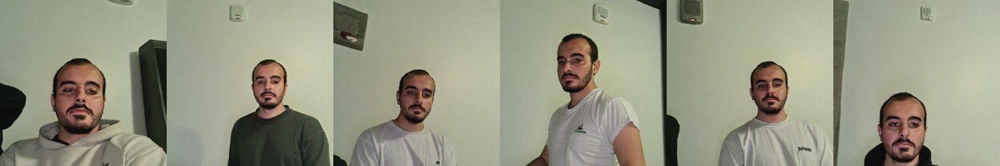

In [21]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=80,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [22]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/DDIM_80_steps_prior"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r DDIM_80_steps_prior.zip "/content/drive/My Drive/DDIM_80_steps_prior"

  adding: content/drive/My Drive/DDIM_80_steps_prior/ (stored 0%)
  adding: content/drive/My Drive/DDIM_80_steps_prior/0.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps_prior/1.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps_prior/2.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps_prior/3.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps_prior/4.png (deflated 0%)
  adding: content/drive/My Drive/DDIM_80_steps_prior/5.png (deflated 0%)


###PNDM

In [24]:
from diffusers import PNDMScheduler

pipe.scheduler = PNDMScheduler.from_config(pipe.scheduler.config)

50 steps

  0%|          | 0/50 [00:00<?, ?it/s]

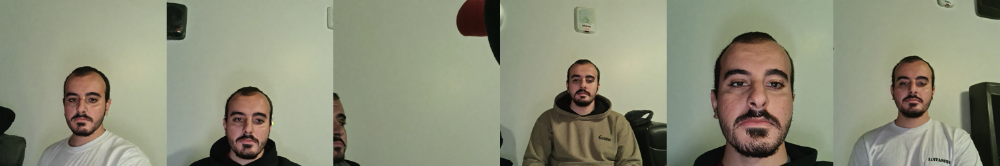

In [25]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=50,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [26]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/PNDM_50_steps_prior"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r PNDM_50_steps_prior.zip "/content/drive/My Drive/PNDM_50_steps_prior"

updating: content/drive/My Drive/PNDM_50_steps_prior/ (stored 0%)
updating: content/drive/My Drive/PNDM_50_steps_prior/0.png (deflated 0%)
updating: content/drive/My Drive/PNDM_50_steps_prior/1.png (deflated 0%)
updating: content/drive/My Drive/PNDM_50_steps_prior/2.png (deflated 0%)
updating: content/drive/My Drive/PNDM_50_steps_prior/3.png (deflated 0%)
updating: content/drive/My Drive/PNDM_50_steps_prior/4.png (deflated 0%)
updating: content/drive/My Drive/PNDM_50_steps_prior/5.png (deflated 0%)


80 steps

  0%|          | 0/80 [00:00<?, ?it/s]

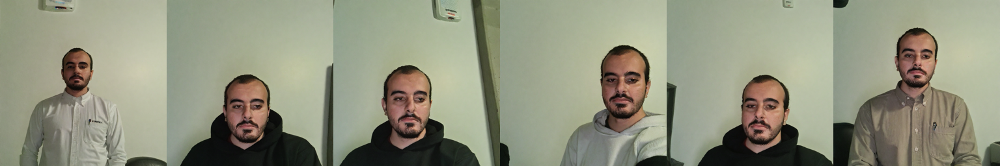

In [27]:
prompt = "a photo of karim person"
images = pipe(prompt=prompt, num_inference_steps=80,num_images_per_prompt=6,generator=generator)
image_grid(images[0], 1, 6)

In [28]:
from pathlib import Path

DIR_NAME="/content/drive/My Drive/PNDM_80_steps_prior"
dirpath = Path(DIR_NAME)
# create parent dir if doesn't exist
dirpath.mkdir(parents=True, exist_ok=True)

for idx, image in enumerate(images.images):
    image_name = f'{idx}.png'
    image_path = dirpath / image_name
    image.save(image_path)

!zip -r PNDM_80_steps_prior.zip "/content/drive/My Drive/PNDM_80_steps_prior"

  adding: content/drive/My Drive/PNDM_80_steps_prior/ (stored 0%)
  adding: content/drive/My Drive/PNDM_80_steps_prior/0.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps_prior/1.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps_prior/2.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps_prior/3.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps_prior/4.png (deflated 0%)
  adding: content/drive/My Drive/PNDM_80_steps_prior/5.png (deflated 0%)
